# Final Project
## Spoken Digit Recognition - Deep Neural Network
### MSCA Machine Learning - Spring Quarter 2022/2023
Rolamjaya Hotmartua - 12370

In [1]:
%%capture
import sys
#!{sys.executable} -m pip install librosa
#!{sys.executable} -m pip install pyyaml h5py 
#!{sys.executable} -m pip install pydub
#!{sys.executable} -m pip install optuna

In [1]:
#
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt
import scipy.io.wavfile as wav
import numpy as np
from keras.preprocessing import image
from keras.utils.np_utils import to_categorical
import optuna

import IPython.display as ipd
import librosa
import librosa.display
import pandas as pd


2023-05-22 21:50:35.390797: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2, in other operations, rebuild TensorFlow with the appropriate compiler flags.


### Data Exploration

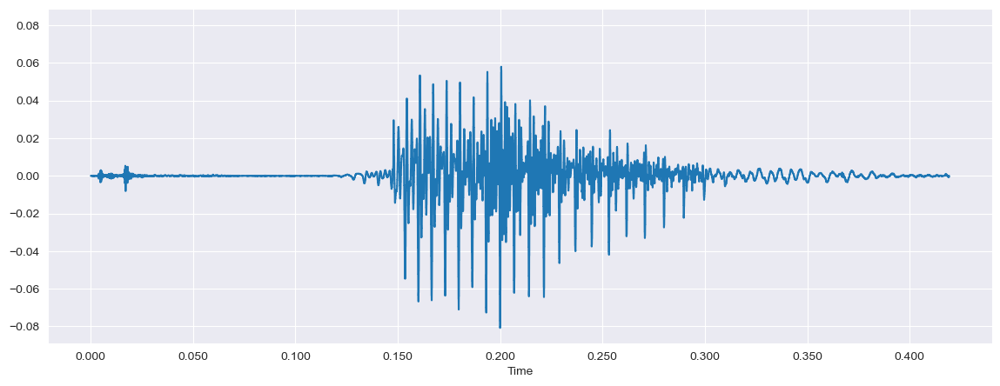

In [55]:
filename = 'free-spoken-digit-dataset-master/recordings/1_yweweler_0.wav'
plt.figure(figsize=(14,5))
data,sample_rate = librosa.load(filename)
librosa.display.waveshow(data,sr=sample_rate)
ipd.Audio(filename)


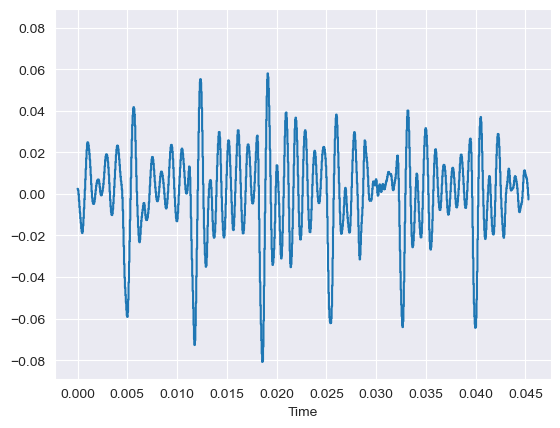

In [56]:
wave = data
non_silent_interval = librosa.effects.split(wave, top_db=0.1, hop_length=1000)
wave = wave[non_silent_interval[0][0]:non_silent_interval[0][1]]
librosa.display.waveshow(wave,sr=sample_rate)

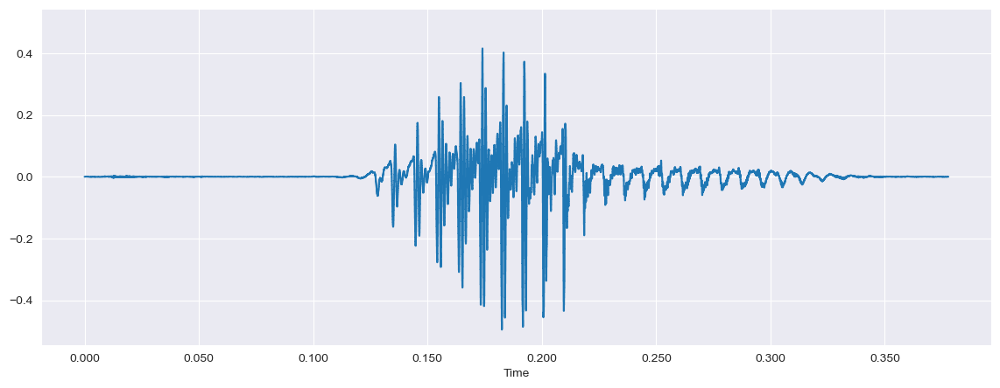

In [53]:
filename = 'free-spoken-digit-dataset-master/recordings/1_lucas_0.wav'
plt.figure(figsize=(14,5))
data,sample_rate = librosa.load(filename)
librosa.display.waveshow(data,sr=sample_rate)
ipd.Audio(filename)


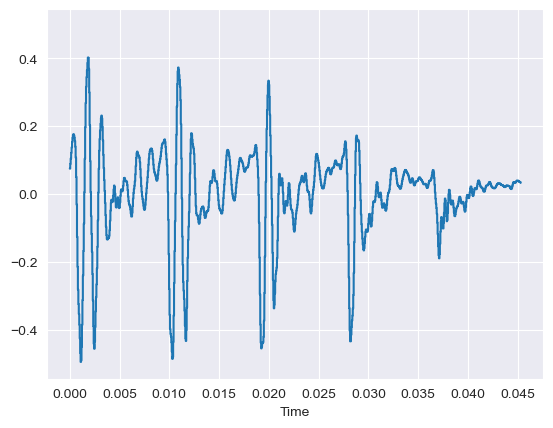

In [54]:
wave = data
non_silent_interval = librosa.effects.split(wave, top_db=0.1, hop_length=1000)
wave = wave[non_silent_interval[0][0]:non_silent_interval[0][1]]
librosa.display.waveshow(wave,sr=sample_rate)

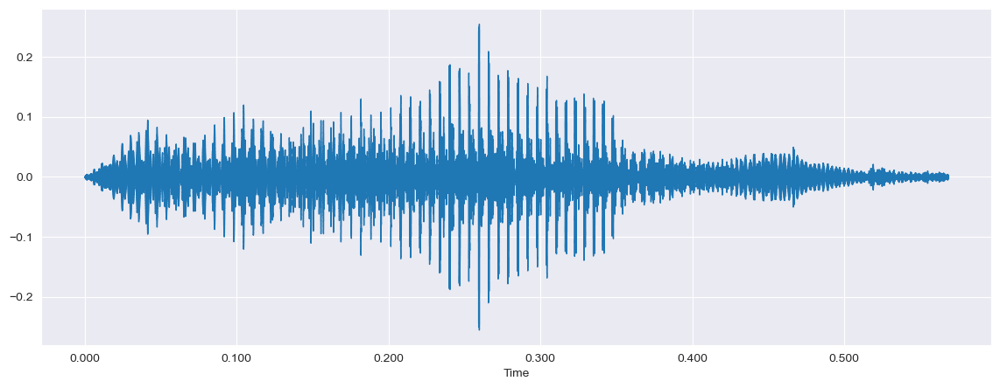

In [51]:
filename = 'free-spoken-digit-dataset-master/recordings/1_george_0.wav'
plt.figure(figsize=(14,5))
data,sample_rate = librosa.load(filename)
librosa.display.waveshow(data,sr=sample_rate)
ipd.Audio(filename)


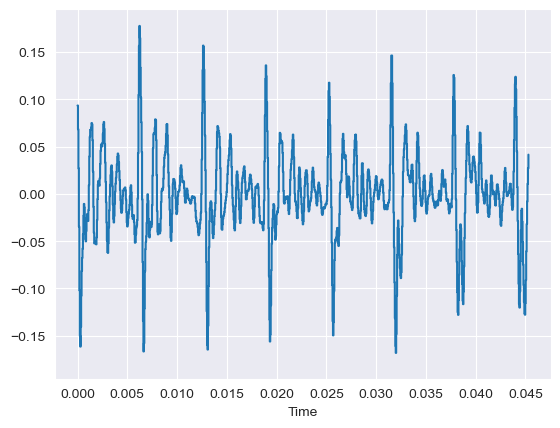

In [52]:
wave = data
non_silent_interval = librosa.effects.split(wave, top_db=0.1, hop_length=1000)
wave = wave[non_silent_interval[0][0]:non_silent_interval[0][1]]
librosa.display.waveshow(wave,sr=sample_rate)

### Data Transformation

Function to convert audio file(wav form) to spectrogram


In [4]:
def wav_to_spectrogram_non_silent(audio_path, save_path, spectrogram_dimensions=(64, 64), noverlap=16, cmap='gray_r'):
    sample_rate, samples = wav.read(audio_path)
    wave = samples
    non_silent_interval = librosa.effects.split(wave, top_db=0.1, hop_length=1000)
    samples = wave[non_silent_interval[0][0]:non_silent_interval[0][1]]
    fig = plt.figure()
    fig.set_size_inches((spectrogram_dimensions[0]/fig.get_dpi(), spectrogram_dimensions[1]/fig.get_dpi()))
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    ax.specgram(samples, cmap=cmap, Fs=2, noverlap=noverlap)
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator())
    fig.savefig(save_path, bbox_inches="tight", pad_inches=0)

In [5]:
def dir_to_spectrogram_non_silent(audio_dir, spectrogram_dir, spectrogram_dimensions=(64, 64), noverlap=16, cmap='gray_r'):
    file_names = [f for f in listdir(audio_dir) if isfile(join(audio_dir, f)) and '.wav' in f]
    for file_name in file_names:
        audio_path = audio_dir + file_name
        spectogram_path = spectrogram_dir + file_name.replace('.wav', '.png')
        wav_to_spectrogram_non_silent(audio_path, spectogram_path, spectrogram_dimensions=spectrogram_dimensions, noverlap=noverlap, cmap=cmap)

/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_84032/1503984774.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_84032/1503984774.py:11: UserWarning: Only one segment is calculated since parameter NFFT (=256) >= signal length (=149).
  ax.specgram(samples, cmap=cmap, Fs=2, noverlap=noverlap)


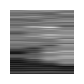

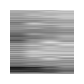

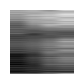

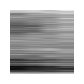

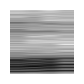

...

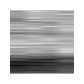

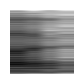

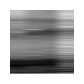

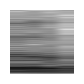

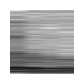

In [6]:
audio_folder = "free-spoken-digit-dataset-master/recordings/"
spectrogram_folder = "free-spoken-digit-dataset-master/spectrograms_cut/"
dir_to_spectrogram_non_silent(audio_folder, spectrogram_folder)

In [7]:
def wav_to_spectrogram(audio_path, save_path, spectrogram_dimensions=(64, 64), noverlap=16, cmap='gray_r'):
    sample_rate, samples = wav.read(audio_path)
    fig = plt.figure()
    fig.set_size_inches((spectrogram_dimensions[0]/fig.get_dpi(), spectrogram_dimensions[1]/fig.get_dpi()))
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    ax.specgram(samples, cmap=cmap, Fs=2, noverlap=noverlap)
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator())
    fig.savefig(save_path, bbox_inches="tight", pad_inches=0)

In [8]:
def dir_to_spectrogram(audio_dir, spectrogram_dir, spectrogram_dimensions=(64, 64), noverlap=16, cmap='gray_r'):
    file_names = [f for f in listdir(audio_dir) if isfile(join(audio_dir, f)) and '.wav' in f]
    for file_name in file_names:
        audio_path = audio_dir + file_name
        spectogram_path = spectrogram_dir + file_name.replace('.wav', '.png')
        wav_to_spectrogram(audio_path, spectogram_path, spectrogram_dimensions=spectrogram_dimensions, noverlap=noverlap, cmap=cmap)


/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_84032/24607933.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


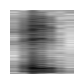

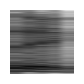

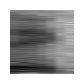

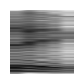

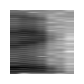

...

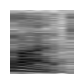

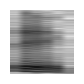

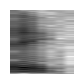

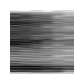

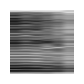

In [16]:
audio_folder = "free-spoken-digit-dataset-master/recordings/"
spectrogram_folder = "free-spoken-digit-dataset-master/spectrograms_ori/"
dir_to_spectrogram(audio_folder, spectrogram_folder)

In [83]:
def wav_to_spectrogram_mel(audio_path, save_path, spectrogram_dimensions=(64, 64), noverlap=16, cmap='gray_r'):
    data,sample_rate = librosa.load(audio_path)
    sgram = librosa.stft(data)
    sgram_mag, _ = librosa.magphase(sgram)
    mel_scale_sgram = librosa.feature.melspectrogram(S=sgram_mag, sr=sample_rate)
    mel_sgram = librosa.amplitude_to_db(mel_scale_sgram, ref=np.min)
    img = librosa.display.specshow(mel_sgram, sr=sample_rate, cmap = cmap)

    plt.savefig(save_path)

In [90]:
def dir_to_spectrogram_mel(audio_dir, spectrogram_dir, spectrogram_dimensions=(64, 64), noverlap=16, cmap='gray_r'):
    file_names = [f for f in listdir(audio_dir) if isfile(join(audio_dir, f)) and '.wav' in f]
    for file_name in file_names:
        audio_path = audio_dir + file_name
        spectogram_path = spectrogram_dir + file_name.replace('.wav', '.png')
        wav_to_spectrogram_mel(audio_path, spectogram_path, spectrogram_dimensions=spectrogram_dimensions, noverlap=noverlap, cmap=cmap)
    print("process finished")

In [85]:
audio_folder = "free-spoken-digit-dataset-master/recordings/"
spectrogram_folder = "free-spoken-digit-dataset-master/spectrograms_ori_mel/"
dir_to_spectrogram_mel(audio_folder, spectrogram_folder)

### Create Train Test set for Spectrogram Scenario 1 
Scenario 1: Training and testing with recording from all speakers. Split: Train = 2700 data and Test = 300 data)

In [44]:
import os
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing import image
from keras.utils.np_utils import to_categorical
from tensorflow.keras.utils import load_img, img_to_array

In [45]:
imagesDir = "free-spoken-digit-dataset-master/spectrograms_ori/"
trainset = [] # Creating two sets (train and test) 
testset = []
valset = []
for file in os.listdir(imagesDir):
    label = file.split('_')[0]
    sample_number = file.split('_')[2]
    img = load_img(imagesDir+file)
    if sample_number in ['0.png','1.png','2.png','3.png','4.png']:
        testset.append([img_to_array(img), label])
    elif sample_number in ['49.png','48.png','47.png','46.png','45.png']:
        valset.append([img_to_array(img), label])
    else:
        trainset.append([img_to_array(img), label])

In [47]:
# Get only images in the train list not the Labels
X_train_ori = [item[0] for item in trainset]
# Get only Labels in the train list not the images
y_train_ori = [item[1] for item in trainset]
# Get only images in the test list not the Labels
X_test_ori = [item[0] for item in testset]
# Get only Labels in the test list not the images
y_test_ori = [item[1] for item in testset]
# Get only images in the val list not the Labels
X_val_ori = [item[0] for item in valset]
# Get only Labels in the val list not the images
y_val_ori = [item[1] for item in valset]

In [48]:
# Convert list to numpy array in order to define input shape
X_train_ori = np.asanyarray(X_train_ori)
y_train_ori = np.asanyarray(y_train_ori)
X_test_ori = np.asanyarray(X_test_ori)
y_test_ori = np.asanyarray(y_test_ori)
X_val_ori = np.asanyarray(X_val_ori)
y_val_ori = np.asanyarray(y_val_ori)

In [49]:
# convert to one hot representation
y_train_ori = to_categorical(y_train_ori)
y_test_ori = to_categorical(y_test_ori)
y_val_ori = to_categorical(y_val_ori)


#Normalize the images
X_train_ori /= 255
X_test_ori /= 255
X_val_ori /= 255

### Create Train Test set for Spectrogram Scenario 2 
Scenario 2: Training with recording data from 5 speakers and Testing with recording data from another speaker. Split: Train = 2500 data and Test = 500 data)(5 speakers: Train and 1 speaker: Test)

In [153]:
imagesDir = "free-spoken-digit-dataset-master/spectrograms_ori/"
trainset = [] # Creating two sets (train and test) 
testset = []
for file in os.listdir(imagesDir):
    label = file.split('_')[0]
    name = file.split('_')[1]
    sample_number = file.split('_')[2]
    img = load_img(imagesDir+file)
    if name == "yweweler":
        testset.append([img_to_array(img), label])
    else:
        trainset.append([img_to_array(img), label])

In [154]:
# Get only images in the train list not the Labels
X_train = [item[0] for item in trainset]
# Get only Labels in the train list not the images
y_train = [item[1] for item in trainset]
# Get only images in the test list not the Labels
X_test = [item[0] for item in testset]
# Get only Labels in the test list not the images
y_test = [item[1] for item in testset]

In [155]:
# Convert list to numpy array in order to define input shape
X_train = np.asanyarray(X_train)
y_train = np.asanyarray(y_train)
X_test = np.asanyarray(X_test)
y_test = np.asanyarray(y_test)

In [156]:
# convert to one hot representation
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

#Normalize the images
X_train /= 255
X_test /= 255

In [157]:
imagesDir = "free-spoken-digit-dataset-master/spectrograms_ori/"
trainset = [] # Creating two sets (train and test) 
testset = []
valset = []
for file in os.listdir(imagesDir):
    label = file.split('_')[0]
    name = file.split('_')[1]
    sample_number = file.split('_')[2]
    img = load_img(imagesDir+file)
    if name == "yweweler":
        testset.append([img_to_array(img), label])
    elif sample_number in ['49.png','48.png','47.png','46.png','45.png']:
        valset.append([img_to_array(img), label])
    else:
        trainset.append([img_to_array(img), label])

In [158]:
# Get only images in the train list not the Labels
X_train_ori_2 = [item[0] for item in trainset]
# Get only Labels in the train list not the images
y_train_ori_2 = [item[1] for item in trainset]
# Get only images in the test list not the Labels
X_test_ori_2 = [item[0] for item in testset]
# Get only Labels in the test list not the images
y_test_ori_2 = [item[1] for item in testset]
# Get only images in the val list not the Labels
X_val_ori_2 = [item[0] for item in valset]
# Get only Labels in the val list not the images
y_val_ori_2 = [item[1] for item in valset]

In [159]:
# Convert list to numpy array in order to define input shape
X_train_ori_2 = np.asanyarray(X_train_ori_2)
y_train_ori_2 = np.asanyarray(y_train_ori_2)
X_test_ori_2 = np.asanyarray(X_test_ori_2)
y_test_ori_2 = np.asanyarray(y_test_ori_2)
X_val_ori_2 = np.asanyarray(X_val_ori_2)
y_val_ori_2 = np.asanyarray(y_val_ori_2)

In [160]:
# convert to one hot representation
y_train_ori_2 = to_categorical(y_train_ori_2)
y_test_ori_2 = to_categorical(y_test_ori_2)
y_val_ori_2 = to_categorical(y_val_ori_2)


#Normalize the images
X_train_ori /= 255
X_test_ori /= 255
X_val_ori /= 255

### Create Train Test set for Mel Spectrogram

In [86]:
imagesDir = "free-spoken-digit-dataset-master/spectrograms_ori_mel/"
trainset = [] # Creating two sets (train and test) 
testset = []
valset = []
for file in os.listdir(imagesDir):
    label = file.split('_')[0]
    sample_number = file.split('_')[2]
    img = load_img(imagesDir+file)
    if sample_number in ['0.png','1.png','2.png','3.png','4.png']:
        testset.append([img_to_array(img), label])
    elif sample_number in ['49.png','48.png','47.png','46.png','45.png']:
        valset.append([img_to_array(img), label])
    else:
        trainset.append([img_to_array(img), label])

In [87]:
# Get only images in the train list not the Labels
X_train_ori_mel = [item[0] for item in trainset]
# Get only Labels in the train list not the images
y_train_ori_mel = [item[1] for item in trainset]
# Get only images in the test list not the Labels
X_test_ori_mel = [item[0] for item in testset]
# Get only Labels in the test list not the images
y_test_ori_mel = [item[1] for item in testset]
# Get only images in the val list not the Labels
X_val_ori_mel = [item[0] for item in valset]
# Get only Labels in the val list not the images
y_val_ori_mel = [item[1] for item in valset]

In [88]:
# Convert list to numpy array in order to define input shape
X_train_ori_mel = np.asanyarray(X_train_ori_mel)
y_train_ori_mel = np.asanyarray(y_train_ori_mel)
X_test_ori_mel = np.asanyarray(X_test_ori_mel)
y_test_ori_mel = np.asanyarray(y_test_ori_mel)
X_val_ori_mel = np.asanyarray(X_val_ori_mel)
y_val_ori_mel = np.asanyarray(y_val_ori_mel)

In [89]:
# convert to one hot representation
y_train_ori_mel = to_categorical(y_train_ori_mel)
y_test_ori_mel = to_categorical(y_test_ori_mel)
y_val_ori_mel = to_categorical(y_val_ori_mel)


#Normalize the images
X_train_ori_mel /= 255
X_test_ori_mel /= 255
X_val_ori_mel /= 255

## Designing the Models

In [26]:
from keras.models import Sequential 
from keras import optimizers
from keras.layers import Dense, Activation, Flatten, Conv2D, MaxPooling2D, Dropout, BatchNormalization
from keras import models
import tensorflow as tf
from sklearn.metriBatchNormalizationmport confusion_matrix,classification_report
import test

## Scenario 1

### Model 0 - 1 CNN layer for Spectrogram

In [109]:
from keras import optimizers

In [110]:
data_shape = (X_train_ori.shape[1], X_train_ori.shape[2], X_train_ori.shape[3])
def CNN_1_layers():
    model = Sequential()
    
    model.add(Conv2D(64, (3, 3), padding='same', input_shape=data_shape,activation='relu'))
    model.add(Flatten())
    model.add(Dense(64,activation='relu'))
    model.add(Dense(10, activation='softmax'))
    
    #adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizers.SGD(lr = 0.001), metrics = ['accuracy'])
    
    return model

In [111]:
model_CNN_1_layers = CNN_1_layers()
model_CNN_1_layers.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 64, 64, 64)        1792      
                                                                 
 flatten_6 (Flatten)         (None, 262144)            0         
                                                                 
 dense_12 (Dense)            (None, 64)                16777280  
                                                                 
 dense_13 (Dense)            (None, 10)                650       
                                                                 
Total params: 16,779,722
Trainable params: 16,779,722
Non-trainable params: 0
_________________________________________________________________


/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/gradient_descent.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [112]:
history = model_CNN_1_layers.fit(X_train_ori, y_train_ori, batch_size=32, epochs=100, 
                                 verbose=0, validation_data = [X_val_ori, y_val_ori],
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

2023-05-23 10:05:35.038354: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-23 10:05:44.387314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


In [113]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [114]:
results = model_CNN_1_layers.evaluate(X_test_ori, y_test_ori)

10/10 [==============================] - 1s 104ms/step - loss: 0.1801 - accuracy: 0.9600


In [115]:
print('Test accuracy: ', results[1])

Test accuracy:  0.9600000381469727


In [116]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_1_layers.predict(X_test_ori, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

12/20 [=================>............] - ETA: 0s

2023-05-23 10:22:13.066390: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


20/20 [==============================] - 0s 9ms/step


In [117]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test_ori, axis=1)

In [118]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
num_classes = len(np.unique(rounded_labels))

# Plot the confusion matrix
plt.figure(figsize=(8, 8))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(num_classes)
plt.xticks(tick_marks, range(num_classes))
plt.yticks(tick_marks, range(num_classes))
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

Confusion Matrix


### Model 0 - 1 CNN layer for Spectrogram

In [119]:
data_shape = (X_train_ori.shape[1], X_train_ori.shape[2], X_train_ori.shape[3])
def CNN_1_layers_B():
    model = Sequential()
    
    model.add(Conv2D(64, (3, 3), padding='same', input_shape=data_shape,activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(64, activation = 'relu'))
    model.add(Dropout(0.25))
    model.add(Dense(10, activation='softmax'))
    
    #adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = "adam", metrics = ['accuracy'])
    
    return model

In [120]:
model_CNN_1_layers_B = CNN_1_layers_B()
model_CNN_1_layers_B.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 64, 64, 64)        1792      
                                                                 
 batch_normalization_2 (Batc  (None, 64, 64, 64)       256       
 hNormalization)                                                 
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 32, 32, 64)       0         
 2D)                                                             
                                                                 
 dropout_7 (Dropout)         (None, 32, 32, 64)        0         
                                                                 
 flatten_7 (Flatten)         (None, 65536)             0         
                                                                 
 dense_14 (Dense)            (None, 64)               

In [121]:
history = model_CNN_1_layers_B.fit(X_train_ori, y_train_ori, batch_size=32, epochs=100, 
                                 verbose=0, validation_data = [X_val_ori, y_val_ori],
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

2023-05-23 10:22:14.352842: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-23 10:22:18.642196: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Restoring model weights from the end of the best epoch: 15.
Epoch 27: early stopping


In [122]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [123]:
results = model_CNN_1_layers_B.evaluate(X_test_ori, y_test_ori)

10/10 [==============================] - 0s 28ms/step - loss: 0.1652 - accuracy: 0.9700


In [124]:
print('Test accuracy: ', results[1])

Test accuracy:  0.9700000286102295


In [125]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_1_layers_B.predict(X_test_ori, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

20/20 [==============================] - 0s 6ms/step


2023-05-23 10:23:59.189441: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


In [126]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test_ori, axis=1)

In [127]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
num_classes = len(np.unique(rounded_labels))

# Plot the confusion matrix
plt.figure(figsize=(8, 8))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(num_classes)
plt.xticks(tick_marks, range(num_classes))
plt.yticks(tick_marks, range(num_classes))
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

Confusion Matrix


### Model 1 - CNN 1 layers for Spectrogram

In [128]:
from keras import optimizers

In [129]:
data_shape = (X_train_ori.shape[1], X_train_ori.shape[2], X_train_ori.shape[3])
def CNN_1_layers_b():
    model = Sequential()
    
    model.add(Conv2D(128, (3, 3), padding='same', input_shape=data_shape))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [130]:
model_CNN_1_layers_b = CNN_1_layers_b()
model_CNN_1_layers_b.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 64, 64, 128)       3584      
                                                                 
 activation (Activation)     (None, 64, 64, 128)       0         
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 32, 32, 128)      0         
 2D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 32, 32, 128)       0         
                                                                 
 flatten_8 (Flatten)         (None, 131072)            0         
                                                                 
 dense_16 (Dense)            (None, 512)               67109376  
                                                      

/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [131]:
history = model_CNN_1_layers_b.fit(X_train_ori, y_train_ori, batch_size=32, epochs=100, 
                                 verbose=0, validation_data=(X_val_ori, y_val_ori),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

2023-05-23 10:24:00.572946: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-23 10:24:09.095098: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Restoring model weights from the end of the best epoch: 19.
Epoch 31: early stopping


In [132]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [133]:
results = model_CNN_1_layers_b.evaluate(X_test_ori, y_test_ori)

10/10 [==============================] - 1s 53ms/step - loss: 0.1191 - accuracy: 0.9767


In [134]:
print('Test accuracy: ', results[1])

Test accuracy:  0.9766666889190674


In [135]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_1_layers_b.predict(X_test_ori, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

 8/20 [===========>..................] - ETA: 0s

2023-05-23 10:28:24.536149: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


20/20 [==============================] - 0s 15ms/step


In [136]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test_ori, axis=1)

In [137]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[30  0  0  0  0  0  0  0  0  0]
 [ 0 28  0  0  0  1  0  1  0  0]
 [ 0  0 30  0  0  0  0  0  0  0]
 [ 0  0  0 30  0  0  0  0  0  0]
 [ 0  0  0  0 30  0  0  0  0  0]
 [ 0  0  0  0  0 30  0  0  0  0]
 [ 0  0  0  1  0  0 29  0  0  0]
 [ 0  0  0  0  0  0  0 30  0  0]
 [ 0  0  0  1  0  0  2  0 27  0]
 [ 0  1  0  0  0  0  0  0  0 29]]


### Model 1 - CNN 1 layers for Spectrogram + Optuna

In [128]:
from keras import optimizers

In [150]:
data_shape = (X_train_ori.shape[1], X_train_ori.shape[2], X_train_ori.shape[3])
def CNN_1_layers_c(NN1,DO1,DO2,LR):
    model = Sequential()
    
    model.add(Conv2D(NN1, (3, 3), padding='same', input_shape=data_shape))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(DO1))
    model.add(Flatten())
    model.add(Dense(128))
    model.add(Activation('relu'))
    model.add(Dropout(DO2))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizers.Adam(lr = LR), metrics = ['accuracy'])
    
    return model

In [151]:
def objective(trial):
    # Define the hyperparameters to be optimized
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    num_filters_1 = trial.suggest_int('num_filters_1', 64, 128)
    #num_filters_2 = trial.suggest_int('num_filters_2', 32, 256)
    dropout_rate_1 = trial.suggest_uniform('dropout_rate_1', 0.1, 0.5)
    dropout_rate_2 = trial.suggest_uniform('dropout_rate_2', 0.1, 0.5)

    # Create the model architecture
    model = CNN_1_layers_c(num_filters_1,dropout_rate_1,dropout_rate_2, learning_rate)
    # Train the model
    history = model.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=0, patience=12))

    # Evaluate the model on the validation set
    loss = np.array(history.history['val_loss']).min()
    accuracy = np.array(history.history['val_accuracy']).max()

    return accuracy

In [152]:
import optuna

study = optuna.create_study(direction='maximize',sampler=optuna.samplers.TPESampler())  # Set the optimization direction (e.g., maximize accuracy)
study.optimize(objective, n_trials=20)  # Perform the optimization with a specified number of trials

# Print the best hyperparameters and the corresponding metric value
best_params = study.best_params
best_value = study.best_value
print('Best parameters:', best_params)
print('Best value:', best_value)

[I 2023-05-23 13:17:58,850] A new study created in memory with name: no-name-fe099837-946f-4883-8941-d09f84b36e32
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_84032/644558588.py:3: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_84032/644558588.py:6: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  dropout_rate_1 = trial.suggest_uniform('dropout_rate', 0.1, 0.5)
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_84032/644558588.py:7: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feat

Best parameters: {'learning_rate': 0.00025980853001852954, 'num_filters_1': 82, 'dropout_rate': 0.12370618259336191}
Best value: 0.8060000538825989


In [176]:
model_CNN_1_layers_d = CNN_1_layers_c(LR= 0.00025980853001852954, NN1= 82, DO1= 0.12370618259336191, DO2= 0.12370618259336191)
model_CNN_1_layers_d.summary()

Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_56 (Conv2D)          (None, 64, 64, 82)        2296      
                                                                 
 activation_96 (Activation)  (None, 64, 64, 82)        0         
                                                                 
 max_pooling2d_54 (MaxPoolin  (None, 32, 32, 82)       0         
 g2D)                                                            
                                                                 
 dropout_105 (Dropout)       (None, 32, 32, 82)        0         
                                                                 
 flatten_56 (Flatten)        (None, 83968)             0         
                                                                 
 dense_112 (Dense)           (None, 128)               10748032  
                                                     

In [177]:
history = model_CNN_1_layers_d.fit(X_train_ori, y_train_ori, batch_size=32, epochs=40, 
                                 verbose=0, validation_data=(X_val_ori, y_val_ori),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

2023-05-23 23:50:09.174839: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-23 23:50:14.929984: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


In [178]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [179]:
results = model_CNN_1_layers_d.evaluate(X_test_ori, y_test_ori)

10/10 [==============================] - 1s 56ms/step - loss: 0.3398 - accuracy: 0.9067


In [180]:
print('Test accuracy: ', results[1])

Test accuracy:  0.9066666960716248


In [168]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_1_layers_b.predict(X_test_ori, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

20/20 [==============================] - 1s 48ms/step


In [169]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test_ori, axis=1)

In [170]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]
 [ 0  0  0  0  0  0  0  0  0 30]]


### Model 2 - CNN 3 layers for Spectrogram

In [28]:
from keras import optimizers

In [29]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def CNN_3_layers():
    model = Sequential()
    
    model.add(Conv2D(128, (3, 3), padding='same', input_shape=data_shape))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(64, (3, 3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(32, (3, 3), padding='same'))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [30]:
model_CNN_3_layers = CNN_3_layers()
model_CNN_3_layers.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 64, 64, 128)       3584      
                                                                 
 activation_7 (Activation)   (None, 64, 64, 128)       0         
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 32, 32, 128)      0         
 2D)                                                             
                                                                 
 dropout_4 (Dropout)         (None, 32, 32, 128)       0         
                                                                 
 conv2d_7 (Conv2D)           (None, 30, 30, 64)        73792     
                                                                 
 activation_8 (Activation)   (None, 30, 30, 64)        0         
                                                      

/opt/conda/lib/python3.7/site-packages/keras/optimizers/optimizer_v2/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [31]:
history = model_CNN_3_layers.fit(X_train, y_train, batch_size=32, epochs=100, 
                                 verbose=1, validation_data=(X_test, y_test),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

Epoch 1/100
66/66 [==============================] - 8s 105ms/step - loss: 2.2750 - accuracy: 0.1481 - val_loss: 2.0335 - val_accuracy: 0.2391
Epoch 2/100
66/66 [==============================] - 7s 101ms/step - loss: 1.4058 - accuracy: 0.5352 - val_loss: 0.7108 - val_accuracy: 0.7826
Epoch 3/100
66/66 [==============================] - 7s 107ms/step - loss: 0.7144 - accuracy: 0.7548 - val_loss: 0.4642 - val_accuracy: 0.8783
Epoch 4/100
66/66 [==============================] - 7s 100ms/step - loss: 0.4467 - accuracy: 0.8538 - val_loss: 0.3069 - val_accuracy: 0.9261
Epoch 5/100
66/66 [==============================] - 7s 104ms/step - loss: 0.3305 - accuracy: 0.8900 - val_loss: 0.2766 - val_accuracy: 0.9130
Epoch 6/100
66/66 [==============================] - 7s 101ms/step - loss: 0.2725 - accuracy: 0.9124 - val_loss: 0.1608 - val_accuracy: 0.9565
Epoch 7/100
66/66 [==============================] - 7s 104ms/step - loss: 0.2208 - accuracy: 0.9276 - val_loss: 0.1626 - val_accuracy: 0.9478

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [33]:
results = model_CNN_3_layers.evaluate(X_test, y_test)

8/8 [==============================] - 0s 21ms/step - loss: 0.0757 - accuracy: 0.9826


In [34]:
print('Test accuracy: ', results[1])

Test accuracy:  0.9826086759567261


In [35]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_3_layers.predict(X_test, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

33/33 [==============================] - 0s 8ms/step


In [36]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test, axis=1)

In [37]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[22  0  0  0  0  0  0  0  0  0]
 [ 0 18  0  0  0  0  0  0  0  0]
 [ 0  0 19  1  0  0  0  0  0  0]
 [ 0  0  0 24  0  0  0  0  0  0]
 [ 0  0  0  0 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0  0  0  0 23  0  0  0]
 [ 0  0  0  0  0  0  0 23  0  0]
 [ 0  0  0  1  0  0  0  0 22  0]
 [ 0  1  0  0  0  0  0  1  0 25]]


### Model 3 - CNN 3 layers for Spectrogram + Batchnormalization

In [136]:
from keras import optimizers

In [150]:
data_shape = (X_train_ori.shape[1], X_train_ori.shape[2], X_train_ori.shape[3])
def CNN_3_layers():
    model = Sequential()
    
    model.add(Conv2D(128, (3, 3), padding='same', input_shape=data_shape))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(64, (3, 3)))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(32, (3, 3), padding='same'))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [151]:
model_CNN_3_layers = CNN_3_layers()
model_CNN_3_layers.summary()

Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_207 (Conv2D)         (None, 64, 64, 128)       3584      
                                                                 
 activation_57 (Activation)  (None, 64, 64, 128)       0         
                                                                 
 batch_normalization_47 (Bat  (None, 64, 64, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_135 (MaxPooli  (None, 32, 32, 128)      0         
 ng2D)                                                           
                                                                 
 dropout_172 (Dropout)       (None, 32, 32, 128)       0         
                                                                 
 conv2d_208 (Conv2D)         (None, 30, 30, 64)      

/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [152]:
history = model_CNN_3_layers.fit(X_train_ori, y_train_ori, batch_size=32, epochs=100, 
                                 verbose=0, validation_data=(X_test_ori, y_test_ori),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

2023-05-22 02:17:15.937657: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-22 02:17:25.771040: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Restoring model weights from the end of the best epoch: 16.
Epoch 28: early stopping


In [153]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [154]:
results = model_CNN_3_layers.evaluate(X_test_ori, y_test_ori)

10/10 [==============================] - 0s 27ms/step - loss: 0.0733 - accuracy: 0.9833


In [155]:
print('Test accuracy: ', results[1])

Test accuracy:  0.9833333492279053


In [156]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_3_layers.predict(X_test_ori, len(y_test_ori)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

 6/34 [====>.........................] - ETA: 0s

2023-05-22 02:19:38.517163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


34/34 [==============================] - 1s 12ms/step


In [157]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test_ori, axis=1)

In [158]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[30  0  0  0  0  0  0  0  0  0]
 [ 0 30  0  0  0  0  0  0  0  0]
 [ 0  0 29  1  0  0  0  0  0  0]
 [ 0  0  0 30  0  0  0  0  0  0]
 [ 0  0  0  0 30  0  0  0  0  0]
 [ 0  0  0  0  0 29  0  0  0  1]
 [ 0  0  0  1  0  0 28  0  1  0]
 [ 0  0  0  0  0  0  0 30  0  0]
 [ 0  0  0  0  0  0  0  0 30  0]
 [ 0  1  0  0  0  0  0  0  0 29]]


### Model 4 - CNN 6 layers for Spectrogram

In [8]:
from keras import optimizers

In [12]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def CNN_6_layers():
    model = Sequential()
    
    model.add(Conv2D(32, (3, 3), padding='same', input_shape=data_shape))
    model.add(Activation('relu'))
    model.add(Conv2D(64, (3, 3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(64, (3, 3), padding='same'))
    model.add(Activation('relu'))
    model.add(Conv2D(64, (3, 3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.5))
    model.add(Conv2D(128, (3, 3), padding='same'))
    model.add(Activation('relu'))
    model.add(Conv2D(128, (3, 3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.5))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [13]:
model_CNN_6_layers = CNN_6_layers()
model_CNN_6_layers.summary()

2023-05-21 15:58:59.360190: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcusolver.so.11'; dlerror: libcusolver.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/nccl2/lib:/usr/local/cuda/extras/CUPTI/lib64
2023-05-21 15:58:59.361386: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1934] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2023-05-21 15:58:59.362018: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI F

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 64, 64, 32)        896       
                                                                 
 activation (Activation)     (None, 64, 64, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 62, 62, 64)        18496     
                                                                 
 activation_1 (Activation)   (None, 62, 62, 64)        0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 31, 31, 64)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 31, 31, 64)        0         
                                                        

/opt/conda/lib/python3.7/site-packages/keras/optimizers/optimizer_v2/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [14]:
history = model_CNN_6_layers.fit(X_train, y_train, batch_size=32, epochs=100, 
                                 verbose=1, validation_data=(X_test, y_test),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

Epoch 1/100
66/66 [==============================] - 12s 155ms/step - loss: 2.3283 - accuracy: 0.1000 - val_loss: 2.3001 - val_accuracy: 0.1174
Epoch 2/100
66/66 [==============================] - 10s 149ms/step - loss: 2.0929 - accuracy: 0.2533 - val_loss: 1.1021 - val_accuracy: 0.6696
Epoch 3/100
66/66 [==============================] - 9s 144ms/step - loss: 1.0170 - accuracy: 0.6438 - val_loss: 0.6134 - val_accuracy: 0.8304
Epoch 4/100
66/66 [==============================] - 9s 144ms/step - loss: 0.5578 - accuracy: 0.8124 - val_loss: 0.2100 - val_accuracy: 0.9217
Epoch 5/100
66/66 [==============================] - 10s 148ms/step - loss: 0.3607 - accuracy: 0.8733 - val_loss: 0.3191 - val_accuracy: 0.9043
Epoch 6/100
66/66 [==============================] - 9s 142ms/step - loss: 0.2795 - accuracy: 0.9095 - val_loss: 0.0961 - val_accuracy: 0.9783
Epoch 7/100
66/66 [==============================] - 10s 149ms/step - loss: 0.2192 - accuracy: 0.9271 - val_loss: 0.0706 - val_accuracy: 0.

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [16]:
results = model_CNN_6_layers.evaluate(X_test, y_test)

8/8 [==============================] - 0s 43ms/step - loss: 0.0706 - accuracy: 0.9783


In [17]:
print('Test accuracy: ', results[1])

Test accuracy:  0.97826087474823


In [18]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_6_layers.predict(X_test, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

33/33 [==============================] - 1s 14ms/step


In [19]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test, axis=1)

In [20]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[22  0  0  0  0  0  0  0  0  0]
 [ 0 18  0  0  0  0  0  0  0  0]
 [ 1  0 19  0  0  0  0  0  0  0]
 [ 0  0  0 24  0  0  0  0  0  0]
 [ 0  0  0  0 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0  0  0  0 22  0  1  0]
 [ 0  0  0  0  0  0  0 23  0  0]
 [ 0  0  0  1  0  0  1  0 21  0]
 [ 0  0  0  0  0  0  0  1  0 26]]


## Scenario 2

## A. Without Filter Image

### Model - CNN 6 Layers - Dropout, Adam, Earlystopping + Optuna

In [11]:
from tensorflow.keras import optimizers

In [12]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def cnn_3(NN_1, NN_2, NN_3, LR, dropout_rate):
    model = Sequential()
    
    model.add(Conv2D(NN_1, (3, 3), padding='same', input_shape=data_shape, activation='relu'))
    model.add(Conv2D(NN_1, (3, 3), activation='relu'))
    #model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_2, (3, 3), padding='same', activation='relu'))
    model.add(Conv2D(NN_2, (3, 3), activation='relu'))
    #model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_3, (3, 3), padding='same', activation='relu'))
    model.add(Conv2D(NN_3, (3, 3), activation='relu'))
    #model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(3, 3)))
    model.add(Dropout(dropout_rate))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(10, activation='softmax'))
    
    #adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizers.Adam(learning_rate = LR), metrics = ['accuracy'])
    
    return model

In [13]:
def objective(trial):
    # Define the hyperparameters to be optimized
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    num_filters_1 = trial.suggest_int('num_filters_1', 32, 64)
    num_filters_2 = trial.suggest_int('num_filters_2', 64, 128)
    num_filters_3 = trial.suggest_int('num_filters_3', 64, 200)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)

    # Create the model architecture
    model = cnn_3(num_filters_1,num_filters_2,num_filters_3,learning_rate,dropout_rate)
    # Train the model
    history = model.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=0, patience=12))

    # Evaluate the model on the validation set
    loss = history.history['val_loss'][-1]
    accuracy = history.history['val_accuracy'][-1]

    return accuracy

In [14]:
import optuna

study = optuna.create_study(direction='maximize',sampler=optuna.samplers.TPESampler())  # Set the optimization direction (e.g., maximize accuracy)
study.optimize(objective, n_trials=12)  # Perform the optimization with a specified number of trials

# Print the best hyperparameters and the corresponding metric value
best_params = study.best_params
best_value = study.best_value
print('Best parameters:', best_params)
print('Best value:', best_value)

[I 2023-05-21 06:44:38,498] A new study created in memory with name: no-name-b67beb85-30c8-4949-8fb3-a3a6e6774194
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  import sys
2023-05-21 06:44:40.488859: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcusolver.so.11'; dlerror: libcusolver.so.11: cannot open shared object file: No such file 

Best parameters: {'learning_rate': 0.0008555147237309634, 'num_filters_1': 61, 'num_filters_2': 90, 'num_filters_3': 129, 'dropout_rate': 0.20605537510212277}
Best value: 0.8548387289047241


In [19]:
model_best = cnn_3(LR = 0.0008555147237309634, NN_1 = 61, NN_2 = 90, NN_3 = 129, dropout_rate = 0.20605537510212277)
model_best.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_78 (Conv2D)          (None, 64, 64, 61)        1708      
                                                                 
 conv2d_79 (Conv2D)          (None, 62, 62, 61)        33550     
                                                                 
 max_pooling2d_39 (MaxPoolin  (None, 31, 31, 61)       0         
 g2D)                                                            
                                                                 
 dropout_52 (Dropout)        (None, 31, 31, 61)        0         
                                                                 
 conv2d_80 (Conv2D)          (None, 31, 31, 90)        49500     
                                                                 
 conv2d_81 (Conv2D)          (None, 29, 29, 90)        72990     
                                                     

In [20]:
history = model_best.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12))

Epoch 29: early stopping


In [21]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [22]:
results = model_best.evaluate(X_test, y_test)

12/12 [==============================] - 1s 52ms/step - loss: 0.6991 - accuracy: 0.8763


In [23]:
print('Test accuracy: ', results[1])

Test accuracy:  0.8763440847396851


In [24]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_best.predict(X_test, len(y_test)//32)

34/34 [==============================] - 1s 21ms/step


In [25]:
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

In [26]:
rounded_labels = np.argmax(y_test, axis=1)

In [27]:
### check the misclassification
y_pred4[rounded_labels == 5]

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [28]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
print(cm)

Confusion Matrix
[[31  0  1  0  4  0  0  1  0  0]
 [ 0 29  0  0  2  4  0  0  0  0]
 [ 0  0 43  0  0  0  0  0  0  0]
 [ 0  0  0 29  0  0  2  0  2  3]
 [ 0  0  0  0 33  0  0  0  0  0]
 [ 0  0  0  0  0 36  0  0  0  0]
 [ 0  0  0  4  0  0 17  0 18  0]
 [ 0  0  0  0  0  0  0 41  0  0]
 [ 0  0  0  0  0  0  1  0 36  0]
 [ 0  0  0  0  0  4  0  0  0 31]]


In [29]:
# Required to save models in HDF5 format
model_best.save("spoken_digit_recognition_best.h5")

### Model - CNN 6 Layers - Dropout, BatchNormalization every two layer, Adam,  Earlystopping

In [11]:
from tensorflow.keras import optimizers

In [12]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def cnn_6_batch(NN_1, NN_2, NN_3, LR, dropout_rate):
    model = Sequential()
    
    model.add(Conv2D(NN_1, (3, 3), padding='same', input_shape=data_shape, activation='relu'))
    model.add(Conv2D(NN_1, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_2, (3, 3), padding='same', activation='relu'))
    model.add(Conv2D(NN_2, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_3, (3, 3), padding='same', activation='relu'))
    model.add(Conv2D(NN_3, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(3, 3)))
    model.add(Dropout(dropout_rate))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(10, activation='softmax'))
    
    #adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizers.Adam(learning_rate = LR), metrics = ['accuracy'])
    
    return model

In [13]:
model_batch = cnn_6_batch(LR = 0.0008555147237309634, NN_1 = 61, NN_2 = 90, NN_3 = 129, dropout_rate = 0.20605537510212277)
model_batch.summary()

2023-05-21 15:56:37.557689: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcusolver.so.11'; dlerror: libcusolver.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/nccl2/lib:/usr/local/cuda/extras/CUPTI/lib64
2023-05-21 15:56:37.569683: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1934] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2023-05-21 15:56:37.623934: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI F

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 64, 64, 61)        1708      
                                                                 
 conv2d_1 (Conv2D)           (None, 62, 62, 61)        33550     
                                                                 
 batch_normalization (BatchN  (None, 62, 62, 61)       244       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 31, 31, 61)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 31, 31, 61)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 31, 31, 90)        4

In [14]:
history = model_batch.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12))

Epoch 22: early stopping


In [15]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [16]:
results = model_batch.evaluate(X_test, y_test)

12/12 [==============================] - 1s 66ms/step - loss: 0.9233 - accuracy: 0.8118


In [17]:
print('Test accuracy: ', results[1])

Test accuracy:  0.8118279576301575


In [18]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_batch.predict(X_test, len(y_test)//32)

34/34 [==============================] - 1s 27ms/step


In [19]:
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

In [20]:
rounded_labels = np.argmax(y_test, axis=1)

In [21]:
### check the misclassification
y_pred4[rounded_labels == 5]

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 7, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [22]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
print(cm)

Confusion Matrix
[[34  0  0  0  1  0  0  2  0  0]
 [ 0 32  0  0  0  3  0  0  0  0]
 [ 9  0 30  0  4  0  0  0  0  0]
 [ 0  0  0 30  0  0  0  0  6  0]
 [ 0  0  0  0 33  0  0  0  0  0]
 [ 0  0  0  0  0 35  0  1  0  0]
 [ 0  0  0 10  0  0  7  0 22  0]
 [ 0  0  0  0  0  0  0 41  0  0]
 [ 0  0  0  0  0  0  0  0 37  0]
 [ 0  0  0  0  0 12  0  0  0 23]]


In [23]:
# Required to save models in HDF5 format
model_batch.save("spoken_digit_recognition_best_2.h5")

### Model - CNN 6 Layers - Dropout, BatchNormalization every layer, Adam,  Earlystopping

In [11]:
from tensorflow.keras import optimizers

In [24]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def cnn_6_batch(NN_1, NN_2, NN_3, LR, dropout_rate):
    model = Sequential()
    
    model.add(Conv2D(NN_1, (3, 3), padding='same', input_shape=data_shape, activation='relu'))
    model.add(BatchNormalization())
    model.add(Conv2D(NN_1, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_2, (3, 3), padding='same', activation='relu'))
    model.add(BatchNormalization())
    model.add(Conv2D(NN_2, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_3, (3, 3), padding='same', activation='relu'))
    model.add(BatchNormalization())
    model.add(Conv2D(NN_3, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(3, 3)))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Dense(10, activation='softmax'))
    
    #adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizers.Adam(learning_rate = LR), metrics = ['accuracy'])
    
    return model

In [25]:
model_batch = cnn_6_batch(LR = 0.0008555147237309634, NN_1 = 61, NN_2 = 90, NN_3 = 129, dropout_rate = 0.20605537510212277)
model_batch.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 64, 64, 61)        1708      
                                                                 
 batch_normalization_3 (Batc  (None, 64, 64, 61)       244       
 hNormalization)                                                 
                                                                 
 conv2d_7 (Conv2D)           (None, 62, 62, 61)        33550     
                                                                 
 batch_normalization_4 (Batc  (None, 62, 62, 61)       244       
 hNormalization)                                                 
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 31, 31, 61)       0         
 2D)                                                             
                                                      

In [26]:
history = model_batch.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12))

Epoch 24: early stopping


In [27]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [28]:
results = model_batch.evaluate(X_test, y_test)

12/12 [==============================] - 1s 85ms/step - loss: 0.4582 - accuracy: 0.8817


In [29]:
print('Test accuracy: ', results[1])

Test accuracy:  0.8817204236984253


In [30]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_batch.predict(X_test, len(y_test)//32)

34/34 [==============================] - 1s 35ms/step


In [31]:
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

In [32]:
rounded_labels = np.argmax(y_test, axis=1)

In [33]:
### check the misclassification
y_pred4[rounded_labels == 5]

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [34]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
print(cm)

Confusion Matrix
[[36  0  0  0  1  0  0  0  0  0]
 [ 0 35  0  0  0  0  0  0  0  0]
 [ 1  0 41  0  1  0  0  0  0  0]
 [ 0  0  0 34  0  0  0  0  2  0]
 [ 0  0  0  0 33  0  0  0  0  0]
 [ 0  0  0  0  0 36  0  0  0  0]
 [ 0  0  3 11  0  0 11  0 14  0]
 [ 0  0  0  0  0  0  0 41  0  0]
 [ 0  0  0  0  0  0  0  0 37  0]
 [ 0  0  0  0  0 10  0  1  0 24]]


In [35]:
# Required to save models in HDF5 format
model_batch.save("spoken_digit_recognition_best_3.h5")

### Model - CNN 6 Layers - Dropout, BatchNormalization every layer, AdamW,  Earlystopping

In [56]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam

class AdamW(Adam):
    def __init__(self, weight_decay_rate=0.01, *args, **kwargs):
        super(AdamW, self).__init__(*args, **kwargs)
        self.weight_decay_rate = weight_decay_rate

    def get_updates(self, loss, params):
        # Apply weight decay before updating the parameters
        if self.weight_decay_rate > 0.0:
            for p in params:
                if p.name in self.exclude_from_weight_decay:
                    continue
                loss += tf.keras.regularizers.l2(self.weight_decay_rate)(p)

        # Call the original Adam's update function
        updates = super(AdamW, self).get_updates(loss, params)
        self.updates = updates
        return self.updates


In [58]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def cnn_6_batch(NN_1, NN_2, NN_3, LR, dropout_rate):
    model = Sequential()
    
    model.add(Conv2D(NN_1, (3, 3), padding='same', input_shape=data_shape, activation='relu'))
    model.add(BatchNormalization())
    model.add(Conv2D(NN_1, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_2, (3, 3), padding='same', activation='relu'))
    model.add(BatchNormalization())
    model.add(Conv2D(NN_2, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_3, (3, 3), padding='same', activation='relu'))
    model.add(BatchNormalization())
    model.add(Conv2D(NN_3, (3, 3), activation='relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(3, 3)))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    model.add(Dense(10, activation='softmax'))
    
    #adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = AdamW(weight_decay_rate=0.01,learning_rate = LR), metrics = ['accuracy'])
    
    return model

In [59]:
model_batch = cnn_6_batch(LR = 0.0008555147237309634, NN_1 = 61, NN_2 = 90, NN_3 = 129, dropout_rate = 0.20605537510212277)
model_batch.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_30 (Conv2D)          (None, 64, 64, 61)        1708      
                                                                 
 batch_normalization_43 (Bat  (None, 64, 64, 61)       244       
 chNormalization)                                                
                                                                 
 conv2d_31 (Conv2D)          (None, 62, 62, 61)        33550     
                                                                 
 batch_normalization_44 (Bat  (None, 62, 62, 61)       244       
 chNormalization)                                                
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 31, 31, 61)       0         
 g2D)                                                            
                                                      

In [60]:
history = model_batch.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12))

Epoch 24: early stopping


In [61]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [62]:
results = model_batch.evaluate(X_test, y_test)

12/12 [==============================] - 1s 85ms/step - loss: 0.8223 - accuracy: 0.8629


In [63]:
print('Test accuracy: ', results[1])

Test accuracy:  0.8629032373428345


In [64]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_batch.predict(X_test, len(y_test)//32)

34/34 [==============================] - 1s 35ms/step


In [65]:
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

In [66]:
rounded_labels = np.argmax(y_test, axis=1)

In [67]:
### check the misclassification
y_pred4[rounded_labels == 5]

array([5, 5, 5, 1, 5, 5, 5, 5, 5, 5, 1, 5, 5, 5, 1, 5, 5, 1, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 1, 5, 5, 5, 5, 5])

In [68]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
print(cm)

Confusion Matrix
[[36  0  1  0  0  0  0  0  0  0]
 [ 0 35  0  0  0  0  0  0  0  0]
 [ 0  0 43  0  0  0  0  0  0  0]
 [ 0  0  0 32  0  0  0  0  4  0]
 [ 0  3  0  0 30  0  0  0  0  0]
 [ 0  5  0  0  0 31  0  0  0  0]
 [ 0  0  1  8  0  0  4  0 26  0]
 [ 0  0  0  0  0  0  0 38  0  3]
 [ 0  0  0  0  0  0  0  0 37  0]
 [ 0  0  0  0  0  0  0  0  0 35]]


In [69]:
# Required to save models in HDF5 format
model_batch.save("spoken_digit_recognition_best_4.h5")

### Model - CNN Model 3 layers - Batch Normalization + Dropout + Earlystopping

In [ ]:
LR = 0.0008555147237309634, NN_1 = 61, NN_2 = 90, NN_3 = 129, dropout_rate = 0.20605537510212277

In [28]:
from keras import optimizers

In [159]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def CNN_3_layers_A():
    model = Sequential()
    
    model.add(Conv2D(128, (3, 3), padding='same', input_shape=data_shape,activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(64, (3, 3), padding='same',activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(32, (3, 3), padding='same',activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [160]:
model_CNN_3_layers = CNN_3_layers_A()
model_CNN_3_layers.summary()

Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_210 (Conv2D)         (None, 64, 64, 128)       3584      
                                                                 
 batch_normalization_50 (Bat  (None, 64, 64, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_138 (MaxPooli  (None, 32, 32, 128)      0         
 ng2D)                                                           
                                                                 
 dropout_176 (Dropout)       (None, 32, 32, 128)       0         
                                                                 
 conv2d_211 (Conv2D)         (None, 32, 32, 64)        73792     
                                                                 
 batch_normalization_51 (Bat  (None, 32, 32, 64)     

/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [162]:
history = model_CNN_3_layers.fit(X_train, y_train, batch_size=32, epochs=100, 
                                 verbose=0, validation_data=(X_test, y_test),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

2023-05-22 10:28:32.877438: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-22 10:28:40.378009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Restoring model weights from the end of the best epoch: 6.
Epoch 18: early stopping


In [163]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [165]:
results = model_CNN_3_layers.evaluate(X_test, y_test)

16/16 [==============================] - 1s 33ms/step - loss: 0.9639 - accuracy: 0.6960


In [166]:
print('Test accuracy: ', results[1])

Test accuracy:  0.6960000395774841


In [168]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_3_layers.predict(X_test, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

2023-05-22 13:58:35.667958: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


34/34 [==============================] - 1s 12ms/step


In [169]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test, axis=1)

In [170]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[49  0  1  0  0  0  0  0  0  0]
 [ 0 49  1  0  0  0  0  0  0  0]
 [ 8  0 42  0  0  0  0  0  0  0]
 [ 0  0  3 29  0  0  5  0 13  0]
 [ 0  8  0  0 42  0  0  0  0  0]
 [ 0  4  0  0  0 38  4  3  0  1]
 [ 2  0  0  4  0  0 25  0 19  0]
 [ 1  9  3  0  0  0  0 34  0  3]
 [ 0  0  6  1  0  0  6  0 37  0]
 [ 1 36  6  0  0  4  0  0  0  3]]


## B. With Filter Image

learning_rate= 1.0485692975202808e-05, num_filters_1= 96, num_filters_2= 65, num_filters_3= 108, dropout_rate= 0.16287371404007384

### Model 1 - CNN Model 3 layers

In [69]:
from keras import optimizers

In [70]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def CNN_3_layers_1():
    model = Sequential()
    
    model.add(Conv2D(128, (3, 3), padding='same', input_shape=data_shape,activation = 'relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(64, (3, 3), padding='same',activation = 'relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(32, (3, 3), padding='same',activation = 'relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [71]:
model_CNN_3_layers = CNN_3_layers_1()
model_CNN_3_layers.summary()

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_153 (Conv2D)         (None, 64, 64, 128)       3584      
                                                                 
 max_pooling2d_81 (MaxPoolin  (None, 32, 32, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_154 (Conv2D)         (None, 32, 32, 64)        73792     
                                                                 
 max_pooling2d_82 (MaxPoolin  (None, 16, 16, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_155 (Conv2D)         (None, 16, 16, 32)        18464     
                                                                 
 max_pooling2d_83 (MaxPoolin  (None, 8, 8, 32)       

/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [72]:
history = model_CNN_3_layers.fit(X_train, y_train, batch_size=32, epochs=50, 
                                 verbose=1, validation_data=(X_test, y_test))

Epoch 1/50


2023-05-22 00:49:03.595019: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


79/79 [==============================] - ETA: 0s - loss: 1.8352 - accuracy: 0.3472

2023-05-22 00:49:09.871671: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


79/79 [==============================] - 7s 70ms/step - loss: 1.8352 - accuracy: 0.3472 - val_loss: 2.8335 - val_accuracy: 0.2940
Epoch 2/50
79/79 [==============================] - 4s 52ms/step - loss: 0.9475 - accuracy: 0.6652 - val_loss: 1.5762 - val_accuracy: 0.4680
Epoch 3/50
79/79 [==============================] - 4s 49ms/step - loss: 0.5859 - accuracy: 0.7972 - val_loss: 1.2786 - val_accuracy: 0.6300
Epoch 4/50
79/79 [==============================] - 5s 57ms/step - loss: 0.4358 - accuracy: 0.8600 - val_loss: 1.2074 - val_accuracy: 0.6860
Epoch 5/50
79/79 [==============================] - 4s 50ms/step - loss: 0.3534 - accuracy: 0.8792 - val_loss: 0.9920 - val_accuracy: 0.6480
Epoch 6/50
79/79 [==============================] - 4s 52ms/step - loss: 0.2426 - accuracy: 0.9136 - val_loss: 1.1653 - val_accuracy: 0.6800
Epoch 7/50
79/79 [==============================] - 4s 52ms/step - loss: 0.1947 - accuracy: 0.9292 - val_loss: 0.7658 - val_accuracy: 0.7540
Epoch 8/50
79/79 [======

In [73]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [74]:
results = model_CNN_3_layers.evaluate(X_test, y_test)

16/16 [==============================] - 0s 26ms/step - loss: 3.1526 - accuracy: 0.6940


In [75]:
print('Test accuracy: ', results[1])

Test accuracy:  0.6940000057220459


In [76]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_3_layers.predict(X_test, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

2023-05-22 00:52:46.491493: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


34/34 [==============================] - 1s 16ms/step


In [77]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test, axis=1)

In [78]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[46  2  0  0  2  0  0  0  0  0]
 [ 0 50  0  0  0  0  0  0  0  0]
 [ 0  1 47  1  1  0  0  0  0  0]
 [ 0  0  1 24  0  0  7  0 18  0]
 [ 0 10  0  0 38  1  0  0  0  1]
 [ 0  1  0  0  0 45  4  0  0  0]
 [ 0  0  0  1  0  0 23  0 26  0]
 [ 0 17  1  0  0  2  0 16  0 14]
 [ 0  0  2  0  0  0  2  0 46  0]
 [ 0 33  0  0  0  5  0  0  0 12]]


In [79]:
# Get the number of classes
num_classes = len(np.unique(rounded_labels))

# Plot the confusion matrix
plt.figure(figsize=(8, 8))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(num_classes)
plt.xticks(tick_marks, range(num_classes))
plt.yticks(tick_marks, range(num_classes))
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

### Model 2 - CNN Model 3 layers - Batch Normalization + Dropout + Earlystopping

In [28]:
from keras import optimizers

In [80]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def CNN_3_layers_2():
    model = Sequential()
    
    model.add(Conv2D(128, (3, 3), padding='same', input_shape=data_shape,activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(64, (3, 3), padding='same',activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(32, (3, 3), padding='same',activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [81]:
model_CNN_3_layers = CNN_3_layers_2()
model_CNN_3_layers.summary()

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_156 (Conv2D)         (None, 64, 64, 128)       3584      
                                                                 
 batch_normalization (BatchN  (None, 64, 64, 128)      512       
 ormalization)                                                   
                                                                 
 max_pooling2d_84 (MaxPoolin  (None, 32, 32, 128)      0         
 g2D)                                                            
                                                                 
 dropout_96 (Dropout)        (None, 32, 32, 128)       0         
                                                                 
 conv2d_157 (Conv2D)         (None, 32, 32, 64)        73792     
                                                                 
 batch_normalization_1 (Batc  (None, 32, 32, 64)     

/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [82]:
history = model_CNN_3_layers.fit(X_train, y_train, batch_size=32, epochs=100, 
                                 verbose=1, validation_data=(X_test, y_test),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

Epoch 1/100


2023-05-22 00:56:06.463123: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


79/79 [==============================] - ETA: 0s - loss: 2.4193 - accuracy: 0.4312

2023-05-22 00:56:20.136583: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


79/79 [==============================] - 15s 122ms/step - loss: 2.4193 - accuracy: 0.4312 - val_loss: 3.0986 - val_accuracy: 0.1380
Epoch 2/100
79/79 [==============================] - 5s 60ms/step - loss: 1.0683 - accuracy: 0.6644 - val_loss: 6.1534 - val_accuracy: 0.1000
Epoch 3/100
79/79 [==============================] - 5s 64ms/step - loss: 0.7412 - accuracy: 0.7628 - val_loss: 6.9277 - val_accuracy: 0.1060
Epoch 4/100
79/79 [==============================] - 6s 75ms/step - loss: 0.5309 - accuracy: 0.8236 - val_loss: 4.4960 - val_accuracy: 0.2540
Epoch 5/100
79/79 [==============================] - 8s 97ms/step - loss: 0.4651 - accuracy: 0.8616 - val_loss: 2.9421 - val_accuracy: 0.4660
Epoch 6/100
79/79 [==============================] - 6s 82ms/step - loss: 0.3718 - accuracy: 0.8904 - val_loss: 1.7830 - val_accuracy: 0.6720
Epoch 7/100
79/79 [==============================] - 5s 61ms/step - loss: 0.3235 - accuracy: 0.8968 - val_loss: 2.0900 - val_accuracy: 0.6200
Epoch 8/100
79/7

In [83]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [84]:
results = model_CNN_3_layers.evaluate(X_test, y_test)

16/16 [==============================] - 0s 22ms/step - loss: 1.5441 - accuracy: 0.7580


In [85]:
print('Test accuracy: ', results[1])

Test accuracy:  0.7580000162124634


In [86]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_3_layers.predict(X_test, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

 1/34 [..............................] - ETA: 6s

2023-05-22 00:58:06.693946: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


34/34 [==============================] - 1s 10ms/step


In [87]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test, axis=1)

In [88]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[48  1  0  0  1  0  0  0  0  0]
 [ 0 48  0  0  0  0  0  2  0  0]
 [ 0  1 48  0  0  0  0  1  0  0]
 [ 0  0  0 25  0  0  0  0 25  0]
 [ 0  3  0  0 45  1  0  0  0  1]
 [ 0  0  0  0  0 38  4  5  0  3]
 [ 0  0  0  1  0  0 18  0 31  0]
 [ 0  8  1  0  0  0  0 41  0  0]
 [ 0  0  0  0  0  0  3  0 47  0]
 [ 0 23  0  1  0  0  0  0  5 21]]


### Model 3 - CNN Model 2 layers - Batch Normalization + Dropout + Earlystopping

In [28]:
from keras import optimizers

In [89]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def CNN_2_layers_1():
    model = Sequential()
    
    model.add(Conv2D(128, (3, 3), padding='same', input_shape=data_shape,activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(64, (3, 3), padding='same',activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [90]:
model_CNN_2_layers = CNN_2_layers_1()
model_CNN_2_layers.summary()

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_159 (Conv2D)         (None, 64, 64, 128)       3584      
                                                                 
 batch_normalization_3 (Batc  (None, 64, 64, 128)      512       
 hNormalization)                                                 
                                                                 
 max_pooling2d_87 (MaxPoolin  (None, 32, 32, 128)      0         
 g2D)                                                            
                                                                 
 dropout_100 (Dropout)       (None, 32, 32, 128)       0         
                                                                 
 conv2d_160 (Conv2D)         (None, 32, 32, 64)        73792     
                                                                 
 batch_normalization_4 (Batc  (None, 32, 32, 64)     

/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [91]:
history = model_CNN_2_layers.fit(X_train, y_train, batch_size=32, epochs=100, 
                                 verbose=1, validation_data=(X_test, y_test),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

Epoch 1/100


2023-05-22 01:06:03.574274: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


79/79 [==============================] - ETA: 0s - loss: 8.4860 - accuracy: 0.3664

2023-05-22 01:06:10.833405: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


79/79 [==============================] - 8s 80ms/step - loss: 8.4860 - accuracy: 0.3664 - val_loss: 14.9460 - val_accuracy: 0.1000
Epoch 2/100
79/79 [==============================] - 5s 64ms/step - loss: 1.4427 - accuracy: 0.5556 - val_loss: 14.5980 - val_accuracy: 0.1000
Epoch 3/100
79/79 [==============================] - 4s 55ms/step - loss: 1.0540 - accuracy: 0.6692 - val_loss: 17.0765 - val_accuracy: 0.1000
Epoch 4/100
79/79 [==============================] - 5s 65ms/step - loss: 0.8139 - accuracy: 0.7648 - val_loss: 12.9041 - val_accuracy: 0.1000
Epoch 5/100
79/79 [==============================] - 5s 64ms/step - loss: 0.7415 - accuracy: 0.7876 - val_loss: 3.0996 - val_accuracy: 0.3620
Epoch 6/100
79/79 [==============================] - 6s 75ms/step - loss: 0.6322 - accuracy: 0.8112 - val_loss: 1.0434 - val_accuracy: 0.6240
Epoch 7/100
79/79 [==============================] - 5s 67ms/step - loss: 0.5179 - accuracy: 0.8444 - val_loss: 1.7709 - val_accuracy: 0.5760
Epoch 8/100
79

In [92]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [93]:
results = model_CNN_2_layers.evaluate(X_test, y_test)

16/16 [==============================] - 0s 26ms/step - loss: 1.0434 - accuracy: 0.6240


In [94]:
print('Test accuracy: ', results[1])

Test accuracy:  0.6240000128746033


In [95]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_2_layers.predict(X_test, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

 8/34 [======>.......................] - ETA: 0s

2023-05-22 01:07:37.429072: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


34/34 [==============================] - 0s 9ms/step


In [96]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test, axis=1)

In [97]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[35  0 11  0  1  0  0  3  0  0]
 [ 0 45  0  0  0  0  0  5  0  0]
 [ 0  0 49  0  0  0  0  1  0  0]
 [ 0  0  0 10  0  0  1  0 39  0]
 [ 0  3  1  0 46  0  0  0  0  0]
 [ 0  0  0  0  2 12  9 27  0  0]
 [ 0  0  0  1  0  0 18  0 31  0]
 [ 0  5  1  0  0  0  0 44  0  0]
 [ 0  0  1  0  0  0  3  0 46  0]
 [ 0 16  0  0  0 15  0  6  6  7]]


### Model 4 - CNN Model 2 layers - Batch Normalization + Dropout + Earlystopping + Hyperparameter Tuning

In [28]:
from keras import optimizers

In [98]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def CNN_2_layers_1(num_filters_1,num_filters_2,num_filters_3,learning_rate,dropout_rate):
    model = Sequential()
    
    model.add(Conv2D(num_filters_1, (3, 3), padding='same', input_shape=data_shape,activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(num_filters_2, (3, 3), padding='same',activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Flatten())
    model.add(Dense(num_filters_3))
    model.add(Activation('relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(10, activation='softmax'))
    
    adam = optimizers.RMSprop(lr = learning_rate)
    model.compile(loss = 'categorical_crossentropy', optimizer = adam, metrics = ['accuracy'])
    
    return model

In [101]:
def objective(trial):
    # Define the hyperparameters to be optimized
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    num_filters_1 = trial.suggest_int('num_filters_1', 32, 128)
    num_filters_2 = trial.suggest_int('num_filters_2', 32, 128)
    num_filters_3 = trial.suggest_int('num_filters_3', 32, 256)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)

    # Create the model architecture
    model = CNN_2_layers_1(num_filters_1,num_filters_2,num_filters_3,learning_rate,dropout_rate)
    # Train the model
    history = model.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=0, patience=12))

    # Evaluate the model on the validation set
    loss = history.history['val_loss'][-1]
    accuracy = history.history['val_accuracy'][-1]

    return accuracy

In [102]:
import optuna

study = optuna.create_study(direction='maximize',sampler=optuna.samplers.TPESampler())  # Set the optimization direction (e.g., maximize accuracy)
study.optimize(objective, n_trials=20)  # Perform the optimization with a specified number of trials

# Print the best hyperparameters and the corresponding metric value
best_params = study.best_params
best_value = study.best_value
print('Best parameters:', best_params)
print('Best value:', best_value)

[I 2023-05-22 01:12:38,910] A new study created in memory with name: no-name-44cf20a5-20d1-4b2a-96b9-a83af8947d41
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_49561/2297630712.py:3: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_49561/2297630712.py:7: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)
/opt/anaconda3/envs/tensorflow/lib/python3.10/site-packages/keras/optimizers/legacy/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `l

Best parameters: {'learning_rate': 1.0485692975202808e-05, 'num_filters_1': 96, 'num_filters_2': 65, 'num_filters_3': 108, 'dropout_rate': 0.16287371404007384}
Best value: 0.7900000214576721


In [103]:
model_CNN_2_layers = CNN_2_layers_1(learning_rate= 1.0485692975202808e-05, num_filters_1= 96, num_filters_2= 65, num_filters_3= 108, dropout_rate= 0.16287371404007384)
model_CNN_2_layers.summary()

Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_201 (Conv2D)         (None, 64, 64, 96)        2688      
                                                                 
 batch_normalization_45 (Bat  (None, 64, 64, 96)       384       
 chNormalization)                                                
                                                                 
 max_pooling2d_129 (MaxPooli  (None, 32, 32, 96)       0         
 ng2D)                                                           
                                                                 
 dropout_163 (Dropout)       (None, 32, 32, 96)        0         
                                                                 
 conv2d_202 (Conv2D)         (None, 32, 32, 65)        56225     
                                                                 
 batch_normalization_46 (Bat  (None, 32, 32, 65)     

In [104]:
history = model_CNN_2_layers.fit(X_train, y_train, batch_size=32, epochs=100, 
                                 verbose=0, validation_data=(X_test, y_test),
                                  callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12, restore_best_weights=True))

2023-05-22 01:56:41.400134: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-22 01:56:48.084830: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Restoring model weights from the end of the best epoch: 12.
Epoch 24: early stopping


In [105]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [106]:
results = model_CNN_2_layers.evaluate(X_test, y_test)

16/16 [==============================] - 0s 24ms/step - loss: 0.6974 - accuracy: 0.7520


In [107]:
print('Test accuracy: ', results[1])

Test accuracy:  0.7520000338554382


In [108]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model_CNN_2_layers.predict(X_test, len(y_test)//32)
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

 6/34 [====>.........................] - ETA: 0s

2023-05-22 01:58:31.920851: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


34/34 [==============================] - 1s 10ms/step


In [109]:
# changing back one hot encoding to the number representation
rounded_labels = np.argmax(y_test, axis=1)

In [110]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
#cm = confusion_matrix(test_RGB_y, y_pred1)
print(cm)

Confusion Matrix
[[46  2  0  0  2  0  0  0  0  0]
 [ 0 48  0  0  0  0  0  2  0  0]
 [ 1  1 48  0  0  0  0  0  0  0]
 [ 0  0  2 35  0  0  0  0 13  0]
 [ 1  3  0  0 46  0  0  0  0  0]
 [ 0  2  0  0  1 43  4  0  0  0]
 [ 0  0  1 15  0  0 18  0 16  0]
 [ 1 13  2  0  0  0  0 32  0  2]
 [ 0  0  4  2  0  0  1  0 43  0]
 [ 0 24  3  2  0  3  0  0  1 17]]


### Model 5 - CNN Model 6 layers - With Hyperparameter Tuning (Optuna)

In [9]:
from tensorflow.keras import optimizers

In [10]:
data_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])
def cnn_3(NN_1, NN_2, NN_3, LR, dropout_rate):
    model = Sequential()
    
    model.add(Conv2D(NN_1, (3, 3), padding='same', input_shape=data_shape, activation='relu'))
    model.add(Conv2D(NN_1, (3, 3), activation='relu'))
    #model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_2, (3, 3), padding='same', activation='relu'))
    model.add(Conv2D(NN_2, (3, 3), activation='relu'))
    #model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_rate))
    model.add(Conv2D(NN_3, (3, 3), padding='same', activation='relu'))
    model.add(Conv2D(NN_3, (3, 3), activation='relu'))
    #model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size=(3, 3)))
    model.add(Dropout(dropout_rate))
    model.add(Flatten())
    model.add(Dense(512))
    model.add(Activation('relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(10, activation='softmax'))
    
    #adam = optimizers.RMSprop(lr = 0.001)
    model.compile(loss = 'categorical_crossentropy', optimizer = optimizers.AdamW(learning_rate = LR), metrics = ['accuracy'])
    
    return model

In [11]:
def objective(trial):
    # Define the hyperparameters to be optimized
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    num_filters_1 = trial.suggest_int('num_filters_1', 32, 64)
    num_filters_2 = trial.suggest_int('num_filters_2', 64, 128)
    num_filters_3 = trial.suggest_int('num_filters_3', 64, 200)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)

    # Create the model architecture
    model = cnn_3(num_filters_1,num_filters_2,num_filters_3,learning_rate,dropout_rate)
    # Train the model
    history = model.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=0, patience=12))

    # Evaluate the model on the validation set
    loss = history.history['val_loss'][-1]
    accuracy = history.history['val_accuracy'][-1]

    return accuracy

In [13]:
import optuna

study = optuna.create_study(direction='maximize',sampler=optuna.samplers.TPESampler())  # Set the optimization direction (e.g., maximize accuracy)
study.optimize(objective, n_trials=20)  # Perform the optimization with a specified number of trials

# Print the best hyperparameters and the corresponding metric value
best_params = study.best_params
best_value = study.best_value
print('Best parameters:', best_params)
print('Best value:', best_value)

[I 2023-05-21 10:27:39,180] A new study created in memory with name: no-name-a3747d98-a36b-4849-900f-6bd84dcd83ad
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_49561/2858659524.py:3: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
/var/folders/qw/g7lmpvlx2255lnn211m1tnp00000gn/T/ipykernel_49561/2858659524.py:7: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)
2023-05-21 10:27:40.267675: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enable

Best parameters: {'learning_rate': 0.0009138557918010273, 'num_filters_1': 57, 'num_filters_2': 101, 'num_filters_3': 119, 'dropout_rate': 0.39376587022299636}
Best value: 0.7120000123977661


In [14]:
model3 = cnn_3(NN_1 = 57, NN_2 = 101, NN_3 = 119, LR = 0.0009138557918010273, dropout_rate = 0.39376587022299636)
model3.summary()

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_138 (Conv2D)         (None, 64, 64, 57)        1596      
                                                                 
 conv2d_139 (Conv2D)         (None, 62, 62, 57)        29298     
                                                                 
 max_pooling2d_69 (MaxPoolin  (None, 31, 31, 57)       0         
 g2D)                                                            
                                                                 
 dropout_92 (Dropout)        (None, 31, 31, 57)        0         
                                                                 
 conv2d_140 (Conv2D)         (None, 31, 31, 101)       51914     
                                                                 
 conv2d_141 (Conv2D)         (None, 29, 29, 101)       91910     
                                                     

In [15]:
history = model3.fit(X_train, y_train, batch_size=32, epochs=100, 
                     verbose=0, validation_data=(X_test, y_test),
                     callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss',mode='min',verbose=1, patience=12))

2023-05-21 12:27:55.206187: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-05-21 12:28:07.575651: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Epoch 28: early stopping


In [16]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")
#get the details form the history object
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

#Train and validation accuracy
plt.plot(epochs, acc, 'b', label='Training accurarcy')
plt.plot(epochs, val_acc, 'r', label='Validation accurarcy')
plt.xlabel('Epoch #')
plt.ylabel('accuracy')
plt.title('Training and Validation accurarcy')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_acc.png')

plt.figure()
#Train and validation loss
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.xlabel('Epoch #')
plt.ylabel('loss')
plt.title('Training and Validation loss')
plt.legend()
#plt.savefig('ensemble_seresnext50_eff-b3_graph_test_loss.png')

plt.show()

In [17]:
results = model3.evaluate(X_test, y_test)

16/16 [==============================] - 0s 24ms/step - loss: 1.1203 - accuracy: 0.6780


In [18]:
print('Test accuracy: ', results[1])

Test accuracy:  0.6780000329017639


In [19]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred4 = model3.predict(X_test, len(y_test)//32)

2023-05-21 12:31:28.533820: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


34/34 [==============================] - 1s 18ms/step


In [20]:
import numpy as np
y_pred4 = np.argmax(Y_pred4, axis=1)

In [21]:
print(y_test.shape, y_pred4.shape)

(500, 10) (500,)


In [22]:
rounded_labels = np.argmax(y_test, axis=1)

In [23]:
print(rounded_labels.shape, y_pred4.shape)

(500,) (500,)


In [24]:
### check the misclassification
y_pred4[rounded_labels == 5]

array([5, 5, 5, 5, 5, 5, 8, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 9, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 5, 9, 5, 6, 5, 5,
       5, 5, 7, 5, 5, 5])

In [25]:
print('Confusion Matrix')
cm = confusion_matrix(rounded_labels, y_pred4)
print(cm)

Confusion Matrix
[[40  1  0  0  6  0  0  0  0  3]
 [ 0 47  1  0  0  1  0  1  0  0]
 [ 0  1 48  0  0  0  0  1  0  0]
 [ 0  0  1 34  0  0  0  0 15  0]
 [ 0  6  0  0 37  7  0  0  0  0]
 [ 0  2  0  0  0 42  2  1  1  2]
 [ 0  0  0  8  0  0 17  0 25  0]
 [ 3 15  1  0  1  0  0 26  0  4]
 [ 0  0  2  1  0  0  3  0 44  0]
 [ 0 31  1  0  1 11  0  0  2  4]]


In [ ]:
# Required to save models in HDF5 format
model3.save("spoken_digit_recognition_3.h5")

In [ ]:
import pickle
pickle_out = open ("classifier.pk1","wb")
pickle.dump(model3,pickle_out)
pickle_out.close()

## Experimenting with out of sample data

Data were generated by the author to see the generalization of the model towards other inputs that come from different sources.

In [ ]:
%%capture
#!pip install pydub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### Data Preparation and Exploration

In [ ]:
# Import the AudioSegment class for processing audio and the 
# split_on_silence function for separating out silent chunks.
from pydub import AudioSegment
from pydub.silence import split_on_silence

# Define a function to normalize a chunk to a target amplitude.
def match_target_amplitude(aChunk, target_dBFS):
    ''' Normalize given audio chunk '''
    change_in_dBFS = target_dBFS - aChunk.dBFS
    return aChunk.apply_gain(change_in_dBFS)

In [ ]:
# Load your audio.
song = AudioSegment.from_mp3("/content/drive/MyDrive/sound_voice/silvia.wav")

In [ ]:
# Split track where the silence is 2 seconds or more and get chunks using 
# the imported function.
chunks = split_on_silence (
    # Use the loaded audio.
    song, 
    # Specify that a silent chunk must be at least 2 seconds or 2000 ms long.
    min_silence_len = 500,
    # Consider a chunk silent if it's quieter than -16 dBFS.
    # (You may want to adjust this parameter.)
    silence_thresh = -35
)

# Process each chunk with your parameters
for i, chunk in enumerate(chunks):

    # Add the padding chunk to beginning and end of the entire chunk.
    audio_chunk =  chunk

    # Normalize the entire chunk.
    audio_chunk = match_target_amplitude(audio_chunk, -40.0)

    # Export the audio chunk with new bitrate.
    print("Exporting brian{0}.wav.".format(i))
    audio_chunk.export(
        "/content/drive/MyDrive/voice/silvia{0}.wav".format(i),
        bitrate = "1411k",
        format = "wav"
    )

Exporting brian0.wav.
Exporting brian1.wav.
Exporting brian2.wav.
Exporting brian3.wav.
Exporting brian4.wav.
Exporting brian5.wav.
Exporting brian6.wav.
Exporting brian7.wav.
Exporting brian8.wav.
Exporting brian9.wav.


In [ ]:
import librosa
import numpy as np
import matplotlib.pyplot as plt


data = wave[non_silent_interval[0][0]:non_silent_interval[0][1]]
# create a hypothetical waveform with 1000 noisy samples and 1000 silent samples
filename = '/content/drive/MyDrive/voice/raras0.wav'
plt.figure(figsize=(14,5))
data,sample_rate = librosa.load(filename)
#wave = data
#non_silent_interval = librosa.effects.split(wave, top_db=0.1, hop_length=1000)
#wave = wave[non_silent_interval[0][0]:non_silent_interval[0][1]]
librosa.display.waveshow(data,sr=sample_rate)
ipd.Audio(filename)

In [ ]:
audio_folder = "/content/drive/MyDrive/voice/"
spectrogram_folder = "/content/drive/MyDrive/voice/spectrograms/"
dir_to_spectrogram(audio_folder, spectrogram_folder)

<ipython-input-47-5c16c3a5386b>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


### Creating Training and Test Dataset

In [115]:
import re
imagesDir = "spectrograms_oos/"
holdout = [] # Creating two sets (train and test) 
for file in os.listdir(imagesDir):
  img = load_img(imagesDir+file)
  label = re.findall(r'\d+',file)[0]
  holdout.append([img_to_array(img), label])

In [116]:
# Get only images in the train list not the Labels
X_holdout = [item[0] for item in holdout]
# Get only Labels in the train list not the images
y_holdout = [item[1] for item in holdout]

In [117]:
X_holdout = np.asanyarray(X_holdout)
y_holdout = np.asanyarray(y_holdout)

# convert to one hot representation
y_holdout = to_categorical(y_holdout)

#Normalize the images
X_holdout /= 255

### Model Testing on New Data

In [ ]:
#from keras.models import load_model
#model_load1 = load_model('/content/drive/MyDrive/free-spoken-digit-dataset-master/spoken_digit_recognition_.h5')

In [118]:
results = model_CNN_2_layers.evaluate(X_holdout, y_holdout)

1/1 [==============================] - 0s 223ms/step - loss: 5.8275 - accuracy: 0.0667


In [27]:
Y_pred_h = model_CNN_6_layers.predict(X_holdout, len(y_holdout)//32)

Y_pred_h = np.argmax(Y_pred_h, axis=1)

Y_pred_h

1/1 [==============================] - 0s 51ms/step


array([4, 4, 1, 4, 4, 4, 4, 4, 4, 4, 1, 1, 4, 4, 4, 4, 4, 2, 4, 4, 4, 2,
       4, 4, 4, 2, 4, 4, 4, 4])

In [38]:
results = model_CNN_3_layers.evaluate(X_holdout, y_holdout)

1/1 [==============================] - 0s 61ms/step - loss: 15.6591 - accuracy: 0.1000


In [40]:
Y_pred_h = model_CNN_3_layers.predict(X_holdout, len(y_holdout)//32)

Y_pred_h = np.argmax(Y_pred_h, axis=1)

Y_pred_h

1/1 [==============================] - 0s 37ms/step


array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 2, 2, 2,
       2, 4, 2, 2, 2, 2, 2, 2])

## Data Augmentation

In [ ]:
import librosa
import numpy as np

# Load the original audio waveform and obtain its spectrogram
audio, sample_rate = librosa.load('path_to_audio.wav')
spectrogram = librosa.feature.melspectrogram(y=audio, sr=sample_rate)

# Data augmentation
shift_amount = np.random.randint(low=-100, high=100)
shifted_spectrogram = np.roll(spectrogram, shift_amount, axis=1)

time_stretched_spectrogram = librosa.effects.time_stretch(spectrogram, rate=0.8)

pitch_shifted_spectrogram = librosa.effects.pitch_shift(spectrogram, sample_rate, n_steps=3)

background_noise, sr = librosa.load('path_to_background_noise.wav')
mixed_spectrogram = spectrogram + np.random.uniform(0, 0.1) * librosa.feature.melspectrogram(y=background_noise, sr=sr, n_mels=spectrogram.shape[0])

# You can further process and save the augmented spectrograms as needed
